In [78]:
import pandas as pd

data = pd.read_csv('data/coronavirus_tweets.csv', header=0, encoding='latin-1')
data

,UserName,ScreenName,Location,TweetAt,OriginalTweet,Sentiment
0,3799,48751,London,16-03-2020,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,Neutral
1,3800,48752,UK,16-03-2020,advice Talk to your neighbours family to excha...,Positive
2,3801,48753,Vagabonds,16-03-2020,Coronavirus Australia: Woolworths to give elde...,Positive
3,3802,48754,NaN,16-03-2020,My food stock is not the only one which is emp...,Positive
4,3803,48755,NaN,16-03-2020,"Me, ready to go at supermarket during the #COV...",Extremely Negative
...,...,...,...,...,...,...
41152,44951,89903,"Wellington City, New Zealand",14-04-2020,Airline pilots offering to stock supermarket s...,Neutral
41153,44952,89904,NaN,14-04-2020,Response to complaint not provided citing COVI...,Extremely Negative
41154,44953,89905,NaN,14-04-2020,You know itÂs getting tough when @KameronWild...,Positive
41155,44954,89906,NaN,14-04-2020,Is it wrong that the smell of hand sanitizer i...,Neutral


In [79]:
possible_sentiments = set(data['Sentiment'])
print(f'Possible sentiments: {set(data["Sentiment"])}')

dict_sent= {}
max = 0
sec_max=0
sec_max_label = ''
for sentiment in possible_sentiments:
    length = len(data['Sentiment'].loc[(data['Sentiment']==sentiment)])
    dict_sent[sentiment] = length
    if (length>max):
        sec_max=max
        sec_max_label=sentiment
        max=length
print(f'Sentiment count: {dict_sent}')
print(f'The second maximum sentiment is "{sec_max_label}" with {sec_max} values')


possible_dates = set(data['TweetAt'].loc[(data['Sentiment']=='Extremely Positive')])
max = 0
max_date = ''
max_date_dict = {}
for date in possible_dates:
    length = len(data['Sentiment'].loc[(data['Sentiment'] =='Extremely Positive') & (data['TweetAt'] == date)])
    max_date_dict[date] = length
    if (length>max):
        max_date=date
        max=length
print(f'Dates count: {max_date_dict}')
print(f'The maximum date is "{max_date}" with {max} values')

Possible sentiments: {'Neutral', 'Extremely Negative', 'Extremely Positive', 'Negative', 'Positive'}
Sentiment count: {'Neutral': 7713, 'Extremely Negative': 5481, 'Extremely Positive': 6624, 'Negative': 9917, 'Positive': 11422}
The second maximum sentiment is "Positive" with 9917 values
Dates count: {'12-04-2020': 139, '13-04-2020': 241, '05-04-2020': 208, '22-03-2020': 375, '04-04-2020': 129, '16-03-2020': 99, '02-04-2020': 141, '30-03-2020': 14, '31-03-2020': 48, '20-03-2020': 478, '08-04-2020': 335, '23-03-2020': 328, '10-04-2020': 167, '11-04-2020': 164, '27-03-2020': 39, '14-04-2020': 44, '06-04-2020': 281, '19-03-2020': 482, '29-03-2020': 23, '17-03-2020': 286, '01-04-2020': 89, '09-04-2020': 288, '25-03-2020': 545, '03-04-2020': 117, '21-03-2020': 426, '28-03-2020': 11, '07-04-2020': 287, '18-03-2020': 408, '24-03-2020': 213, '26-03-2020': 219}
The maximum date is "25-03-2020" with 545 values


In [80]:
import re
from nltk.tokenize import word_tokenize
import nltk
nltk.download('punkt')

punctuation_pattern = r'[^\w\s]'
def remove_punctuation(text):
    # Define the regex pattern to match punctuation
    punctuation_pattern = r'[^\w\s]'
    # Replace punctuation with an empty string
    clean_text = re.sub(punctuation_pattern, '', text)
    return clean_text
data['OriginalTweet'] = data['OriginalTweet'].apply(lambda x: remove_punctuation(x))
def count_words(string):
    return len(word_tokenize(string))
data["word_count"] = data['OriginalTweet'].apply(count_words)
def count_unique_words(string):
    return len(set(word_tokenize(string)))
data["unique_count"] = data['OriginalTweet'].apply(count_unique_words)

import textblob


long_string = "".join(data['OriginalTweet'])
verse = textblob.TextBlob(long_string)
print(f'Words: {verse.words}')
print(f'Words count: {verse.word_counts}')

unique_words = sum(1 for value in verse.word_counts.values() if value == 1)
highest_values = sorted(verse.word_counts.items(), key=lambda x: x[1], reverse=True)[:10]


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\santiago.calderon\AppData\Roaming\nltk_data..
[nltk_data]     .
[nltk_data]   Package punkt is already up-to-date!


Words: ['MeNyrbie', 'Phil_Gahan', 'Chrisitv', 'httpstcoiFz9FAn2Pa', 'and', 'httpstcoxX6ghGFzCC', 'and', 'httpstcoI2NlzdxNo8advice', 'Talk', 'to', 'your', 'neighbours', 'family', 'to', 'exchange', 'phone', 'numbers', 'create', 'contact', 'list', 'with', 'phone', 'numbers', 'of', 'neighbours', 'schools', 'employer', 'chemist', 'GP', 'set', 'up', 'online', 'shopping', 'accounts', 'if', 'poss', 'adequate', 'supplies', 'of', 'regular', 'meds', 'but', 'not', 'over', 'orderCoronavirus', 'Australia', 'Woolworths', 'to', 'give', 'elderly', 'disabled', 'dedicated', 'shopping', 'hours', 'amid', 'COVID19', 'outbreak', 'httpstcobInCA9Vp8PMy', 'food', 'stock', 'is', 'not', 'the', 'only', 'one', 'which', 'is', 'empty', 'PLEASE', 'dont', 'panic', 'THERE', 'WILL', 'BE', 'ENOUGH', 'FOOD', 'FOR', 'EVERYONE', 'if', 'you', 'do', 'not', 'take', 'more', 'than', 'you', 'need', 'Stay', 'calm', 'stay', 'safe', 'COVID19france', 'COVID_19', 'COVID19', 'coronavirus', 'confinement', 'Confinementotal', 'ConfinementG

In [81]:
print(f'Number of unique words: {unique_words}')
print("10 most frequent words:")
for key, value in highest_values:
    print(f"{key}: {value}")

Number of unique words: 76024
10 most frequent words:
the: 42874
to: 38059
and: 23864
of: 21437
a: 18713
in: 18559
coronavirus: 15020
for: 13826
covid19: 12340
is: 12048


In [84]:
import requests
from nltk.stem import PorterStemmer

stopwords = requests.get("https://raw.githubusercontent.com/fozziethebeat/S-Space/master/data/english-stop-words-large.txt").content.decode('utf 8').split ("\n")
stopwords
ps = PorterStemmer()
not_stop_words = [ps.stem(k.lower()) for k in verse.words if (k.lower() not in stopwords and len(k.lower()) > 2)]

verse = textblob.TextBlob(" ".join(not_stop_words))
print(f'Words: {verse.words}')
print(f'Words count: {verse.word_counts}')

unique_words = sum(1 for value in verse.word_counts.values() if value == 1)
print(f'Number of unique words: {unique_words}')
highest_values = sorted(verse.word_counts.items(), key=lambda x: x[1], reverse=True)[:10]
print("10 most frequent words:")
for key, value in highest_values:
    print(f"{key}: {value}")

Words: ['menyrbi', 'phil_gahan', 'chrisitv', 'httpstcoifz9fan2pa', 'httpstcoxx6ghgfzcc', 'httpstcoi2nlzdxno8adv', 'talk', 'neighbour', 'famili', 'exchang', 'phone', 'number', 'creat', 'contact', 'list', 'phone', 'number', 'neighbour', 'school', 'employ', 'chemist', 'set', 'onlin', 'shop', 'account', 'poss', 'adequ', 'suppli', 'regular', 'med', 'ordercoronaviru', 'australia', 'woolworth', 'give', 'elderli', 'disabl', 'dedic', 'shop', 'hour', 'amid', 'covid19', 'outbreak', 'httpstcobinca9vp8pmi', 'food', 'stock', 'empti', 'dont', 'panic', 'food', 'stay', 'calm', 'stay', 'safe', 'covid19fr', 'covid_19', 'covid19', 'coronaviru', 'confin', 'confinementot', 'confinementgen', 'httpstcozrlg0z520jm', 'readi', 'supermarket', 'covid19', 'outbreak', 'paranoid', 'food', 'stock', 'litterali', 'empti', 'coronaviru', 'thing', 'dont', 'panic', 'shortag', 'coronavirusfr', 'restezchezv', 'stayathom', 'confin', 'httpstcousmualq72na', 'news', 'regionâ', 'confirm', 'covid19', 'case', 'sullivan', 'counti', '

In [96]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer

coun_vect = CountVectorizer(max_features=50)
count_matrix = coun_vect.fit_transform(data['OriginalTweet'])
count_array = count_matrix.toarray()
df = pd.DataFrame(data=count_array,columns = coun_vect.get_feature_names_out())

,19,all,amp,and,are,as,at,be,but,by,...,the,they,this,to,up,we,will,with,you,your
0,0,0,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,1,0,...,0,0,0,2,1,0,0,1,0,1
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
3,0,0,0,0,0,0,0,1,0,0,...,1,0,0,0,0,0,1,0,2,0
4,0,0,0,0,0,0,1,0,2,0,...,2,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41152,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
41153,0,0,0,0,0,0,0,0,0,0,...,0,0,0,2,0,0,0,0,0,0
41154,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
41155,0,0,0,0,0,0,0,0,0,0,...,1,0,0,1,0,0,0,0,0,0








<class 'sklearn.naive_bayes.MultinomialNB'>
Score: 0.3033041788143829
Training score: 0.3145430394920141
Test score: 0.3033041788143829
Accuracy: 0.3033041788143829
Precision per class: [0.26464646 0.31848984 0.29717931 0.31912965 0.29960872]
Recall per class: [0.09747024 0.19819277 0.35542169 0.3703314  0.37029361]
F1-score per class: [0.14246873 0.24433717 0.32370154 0.34282932 0.331222  ]


<Figure size 640x480 with 0 Axes>

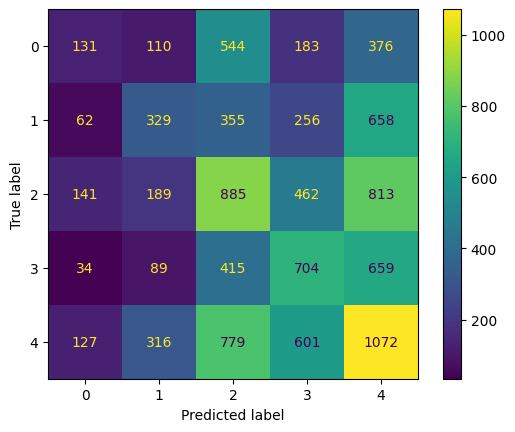

In [98]:
from sklearn.naive_bayes import MultinomialNB
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

X = df
y = data.loc[:, (data.columns == 'Sentiment')]
y = np.array(y).ravel()
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 0)
clf = MultinomialNB()
clf.fit(X_train, y_train)
from sklearn.metrics import ConfusionMatrixDisplay
import matplotlib.pyplot as plt
from sklearn import metrics

def compute_metrics(model):
    y_pred = model.predict(X_test)
    score = 0
    for output in zip(y_pred, y_test):
        score = (score + 1) if output[0] == output[1] else score
    score = score / len(y_test)
    print(f'\n\n\n\n\n\n{type(clf)}')
    print(f'Score: {score}')

    print(f'Training score: {model.score(X_train, y_train)}')
    print(f'Test score: {model.score(X_test, y_test)}')
    print(f'Accuracy: {metrics.accuracy_score(y_test, y_pred)}')
    print(f'Precision per class: {metrics.precision_score(y_test, y_pred, average = None)}')
    print(f'Recall per class: {metrics.recall_score(y_test, y_pred, average = None)}')
    print(f'F1-score per class: {metrics.f1_score(y_test, y_pred, average = None)}')
    plt.figure()
    confusion_matrix = metrics.confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix)
    disp.plot()
    plt.show()
compute_metrics(clf)